In [1]:
import sys
sys.path.append(r'D:\Python ML\SA-geochemical-maps\src')
import cartopy.crs as ccrs
from matplotlib.colors import BoundaryNorm, LogNorm
import matplotlib.pyplot as plt
import matplotlib as mpl


import create_chem_dataset as ccd
import max_dh_chem as mdc
from interpolation import MapBase, interpolate

import pandas as pd
import numpy as np

In [2]:
source_path = r'D:\Unearthed_SARIG_Data_Package\SARIG_Data_Package\sarig_rs_chem_exp.csv'
out_path = r'D:\Python ML\SA-geochemical-maps\Data\Processed_2'
drill_hole_spatial = r'D:\Python ML\SA-geochemical-maps\Data\interim\DH_data.csv'
method_path = r'D:\Python ML\SA-geochemical-maps\notebooks\chem_method_code_map.csv'


In [3]:
elements = ['Fe2O3','U','Ag','Pb','Cu','Zn','Co','Li','Ni','Fe','NiO', 'U3O8', 'Au', 'FeO', 'CoO']

element = 'U'

In [4]:
clean_U = ccd.create_dh_chem_data(source_path, element, method_path, out_path)
clean_U3O8 = ccd.create_dh_chem_data(source_path, element='U3O8', method_path=method_path, out_path=out_path)

Need to remove spurious samples and holes as determined during the EDA phase, before determining max DH value

In [5]:
clean_U.drop(clean_U[clean_U.DETERMINATION.str.contains(r'unknown', na=False, regex=False)].index, inplace=True)
clean_U.drop(clean_U[clean_U.DETERMINATION.str.contains(r'UKN', na=False, regex=False)].index, inplace=True)
clean_U.drop(clean_U[clean_U.DETERMINATION.str.contains(r'pXRF', na=False, regex=False)].index, inplace=True)

clean_U3O8.drop(clean_U3O8[clean_U3O8.DETERMINATION.str.contains(r'unknown', na=False, regex=False)].index, inplace=True)
clean_U3O8.drop(clean_U3O8[clean_U3O8.DETERMINATION.str.contains(r'UKN', na=False, regex=False)].index, inplace=True)
clean_U3O8.drop(clean_U3O8[clean_U3O8.DETERMINATION.str.contains(r'pXRF', na=False, regex=False)].index, inplace=True)



In [6]:
clean_U3O8.tail()

,SAMPLE_NO,SAMPLE_SOURCE_CODE,DRILLHOLE_NUMBER,DH_DEPTH_FROM,DH_DEPTH_TO,SAMPLE_ANALYSIS_NO,ANALYSIS_TYPE_DESC,LABORATORY,CHEM_CODE,VALUE,UNIT,CHEM_METHOD_CODE,BDL,converted_ppm,DETERMINATION,DIGESTION,FUSION
127570,2129772,DC,285005.0,401.0,402.0,1681854,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",U3O8,18.656716,ppm,AAS,0,18.656716,AAS,N/S,unknown
127575,2129773,DC,285005.0,402.0,403.0,1681855,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",U3O8,30.529172,ppm,AAS,0,30.529172,AAS,N/S,unknown
127580,2129774,DC,285005.0,403.0,404.0,1681856,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",U3O8,114.484396,ppm,AAS,0,114.484396,AAS,N/S,unknown
127585,2129775,DC,285005.0,404.0,405.0,1681857,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",U3O8,245.929444,ppm,AAS,0,245.929444,AAS,N/S,unknown
127590,2129776,DC,285005.0,405.0,406.0,1681858,GEOCHEMISTRY,"Comlabs Pty Ltd, S.A.",U3O8,127.204885,ppm,AAS,0,127.204885,AAS,N/S,unknown


Join Ni and NiO tables together

In [7]:
clean_U = clean_U.append(clean_U3O8)

In [8]:
norm_data = mdc.max_dh_chem(clean_U, drill_hole_spatial)

Normalise max dh data to average crustal abundance

In [9]:
norm_data['times_ave_crustal_abund'] = norm_data.converted_ppm.apply(lambda x: x / 1.3)

In [10]:
norm_data.head()

,SAMPLE_NO,SAMPLE_SOURCE_CODE,DRILLHOLE_NUMBER,DH_DEPTH_FROM,DH_DEPTH_TO,SAMPLE_ANALYSIS_NO,ANALYSIS_TYPE_DESC,LABORATORY,CHEM_CODE,VALUE,...,BDL,converted_ppm,DETERMINATION,DIGESTION,FUSION,DH_NAME,SITE_NO,LONGITUDE_GDA2020,LATITUDE_GDA2020,times_ave_crustal_abund
0,2078892,SLAB,148.0,340.00,350.00,1647439,GEOCHEMISTRY,"ALS Chemex, Perth WA",U,1.51,...,0,1.51,ICP-MS,FU,unknown,BN 1,182,129.166978,-31.168831,1.161538
1,791832,DC,205867.0,481.00,482.00,411647,GEOCHEMISTRY,"AMDEL Laboratory, S.A.",U,230.00,...,0,230.00,ICP-OES,AR,unknown,PH04D067,940668,135.575892,-29.717112,176.923077
2,2946481,HCORE,332822.0,22.00,23.00,2453992,GEOCHEMISTRY,"ALS Chemex, Adelaide SA",U,3.00,...,0,3.00,XRF,FU,unknown,HDD-368,2125414,137.867845,-34.537553,2.307692
3,2078884,SLAB,149.0,382.80,384.43,1647430,GEOCHEMISTRY,"ALS Chemex, Perth WA",U,1.65,...,0,1.65,ICP-MS,FU,unknown,BN 2,183,129.163525,-31.162481,1.269231
4,2132936,CT,258.0,318.21,330.40,1688387,GEOCHEMISTRY,"ALS Chemex, Perth WA",U,0.54,...,0,0.54,ICP-MS,FU,unknown,ALBALA-KAROO,278,129.581034,-31.461023,0.415385


In [11]:
norm_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 58862 entries, 0 to 58861
Data columns (total 22 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   SAMPLE_NO                58862 non-null  int64  
 1   SAMPLE_SOURCE_CODE       58859 non-null  object 
 2   DRILLHOLE_NUMBER         58862 non-null  float64
 3   DH_DEPTH_FROM            58836 non-null  float64
 4   DH_DEPTH_TO              58706 non-null  float64
 5   SAMPLE_ANALYSIS_NO       58862 non-null  int64  
 6   ANALYSIS_TYPE_DESC       58862 non-null  object 
 7   LABORATORY               56905 non-null  object 
 8   CHEM_CODE                58862 non-null  object 
 9   VALUE                    58862 non-null  float64
 10  UNIT                     58862 non-null  object 
 11  CHEM_METHOD_CODE         58862 non-null  object 
 12  BDL                      58862 non-null  int64  
 13  converted_ppm            58862 non-null  float64
 14  DETERMINATION         

In [12]:
norm_data.loc[norm_data['converted_ppm'].idxmax()]

SAMPLE_NO                        1968257
SAMPLE_SOURCE_CODE                    DC
DRILLHOLE_NUMBER                271728.0
DH_DEPTH_FROM                      600.0
DH_DEPTH_TO                        602.0
SAMPLE_ANALYSIS_NO               1537121
ANALYSIS_TYPE_DESC          GEOCHEMISTRY
LABORATORY                           NaN
CHEM_CODE                           U3O8
VALUE                          15.264586
UNIT                                   %
CHEM_METHOD_CODE                 COM AAS
BDL                                    0
converted_ppm              152645.861601
DETERMINATION                        AAS
DIGESTION                            N/S
FUSION                           unknown
DH_NAME                            TOD 1
SITE_NO                          1839488
LONGITUDE_GDA2020             136.755818
LATITUDE_GDA2020              -30.337259
times_ave_crustal_abund    117419.893539
Name: 32269, dtype: object

In [13]:
norm_data.times_ave_crustal_abund.min()

0.0007692307692307692

In [14]:
max_v, min_v = norm_data.times_ave_crustal_abund.max().astype(int), norm_data.times_ave_crustal_abund.min().astype(int) 
print(f'For the element {element}: the max value range is {max_v}, while the min is {min_v}')

proj = ccrs.epsg(3107)   #GDA 94/SA Lambert
levels = list(range(min_v, max_v, 1))
cmap = plt.get_cmap('plasma')
#norm = BoundaryNorm(levels, ncolors=cmap.N, clip=True)
log_norm = LogNorm()
n_dh = len(norm_data.DRILLHOLE_NUMBER)

For the element U: the max value range is 117419, while the min is 0


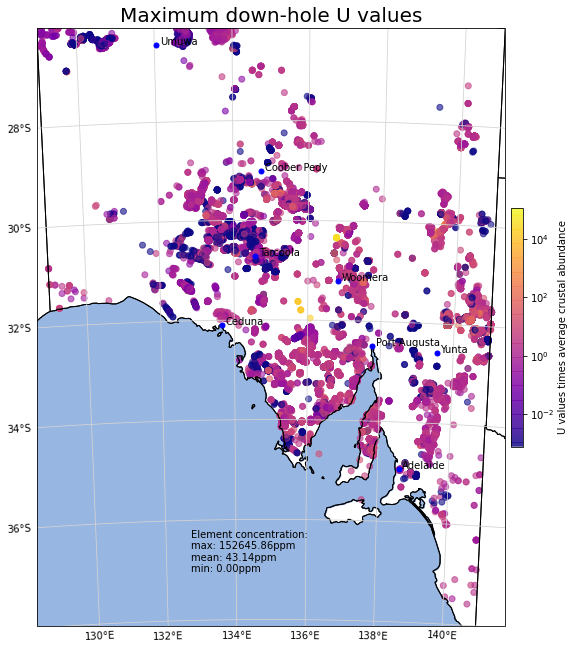

In [15]:
mpl.rcParams['agg.path.chunksize'] = 10000

title = f'Maximum down-hole {element} values'
label = f'{element} values times average crustal abundance'
out_fig = out_path+'\\'+f'Max_downhole_{element}.jpg'
inset_title = f'Number of drill holes:\n{n_dh}'
x, y = norm_data.LONGITUDE_GDA2020.values, norm_data.LATITUDE_GDA2020.values
max_val, min_val, mean_val = norm_data.converted_ppm.max(), norm_data.converted_ppm.min(), norm_data.converted_ppm.mean()
annot = f'Element concentration:\nmax: {max_val:.2f}ppm\nmean: {mean_val:.2f}ppm\nmin: {min_val:.2f}ppm'

fig, view, inset = MapBase(proj, title, inset_title, add_inset=False)
plot = view.scatter(x, y, c=norm_data.times_ave_crustal_abund, cmap=cmap, norm=log_norm, alpha=0.6, transform=ccrs.PlateCarree())
fig.colorbar(plot, ax=view, shrink=.4, pad=0.01, label=label) #boundaries=levels, 
#inset.plot(x, y,color='blue', marker='o', markersize=2, linestyle='None', transform=ccrs.Geodetic())
    
view.annotate(text=annot, xy=(0.33,0.09), xycoords='axes fraction')
plt.savefig(out_fig, dpi=300, bbox_inches='tight')
plt.show()

In [16]:
gx, gy, img = interpolate(norm_data, proj)

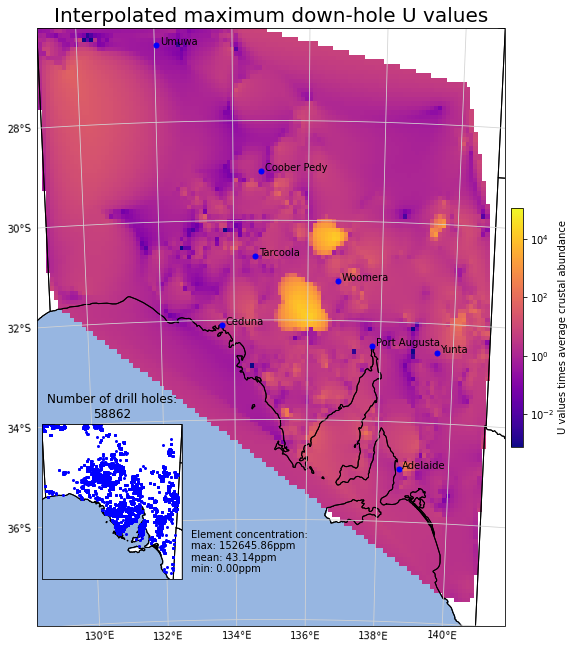

In [17]:
title = f'Interpolated maximum down-hole {element} values'
label = f'{element} values times average crustal abundance'
out_fig = out_path+'\\'+f'Interp_Max_downhole_{element}.jpg'
inset_title = f'Number of drill holes:\n{n_dh}'
x, y = norm_data.LONGITUDE_GDA2020.values, norm_data.LATITUDE_GDA2020.values
max_val, min_val, mean_val = norm_data.converted_ppm.max(), norm_data.converted_ppm.min(), norm_data.converted_ppm.mean()
annot = f'Element concentration:\nmax: {max_val:.2f}ppm\nmean: {mean_val:.2f}ppm\nmin: {min_val:.2f}ppm'

fig, view, inset = MapBase(proj, title, inset_title)
mmb = view.pcolormesh(gx, gy, img, cmap=cmap, norm=log_norm)
fig.colorbar(mmb, ax=view, shrink=.4, pad=0.01, label=label) #boundaries=levels, 
inset.plot(x, y,color='blue', marker='o', markersize=2, linestyle='None', transform=ccrs.Geodetic())
    
view.annotate(text=annot, xy=(0.33,0.09), xycoords='axes fraction')
plt.savefig(out_fig, dpi=300, bbox_inches='tight')
plt.show()